<a href="https://colab.research.google.com/github/ZhongdiChu/uw-reproducibility-2019/blob/master/BNDP_HyperTD_RGB.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')
import tensorflow as tf
tf.test.gpu_device_name()
!ln -sf /opt/bin/nvidia-smi /usr/bin/nvidia-smi
!pip install gputil
!pip install psutil
!pip install humanize
import psutil
import humanize
import os
import GPUtil as GPU
GPUs = GPU.getGPUs()
# XXX: only one GPU on Colab and isn’t guaranteed
gpu = GPUs[0]
def printm():
 process = psutil.Process(os.getpid())
 print("Gen RAM Free: " + humanize.naturalsize( psutil.virtual_memory().available ), " | Proc size: " + humanize.naturalsize( process.memory_info().rss))
 print("GPU RAM Free: {0:.0f}MB | Used: {1:.0f}MB | Util {2:3.0f}% | Total {3:.0f}MB".format(gpu.memoryFree, gpu.memoryUsed, gpu.memoryUtil*100, gpu.memoryTotal))
printm() 

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Gen RAM Free: 25.8 GB  | Proc size: 922.9 MB
GPU RAM Free: 15931MB | Used: 349MB | Util   2% | Total 16280MB


In [28]:
from keras.preprocessing import image
import os
import numpy as np
from skimage.io import imsave, imread

npzfile = np.load('/content/drive/MyDrive/ARVOHTD/HTDDataNew.npz')
HTD_imgs_subRPE = np.load('/content/drive/MyDrive/ARVOHTD/HTD_imgs_subRPE.npy')/255
Normal_imgs_subRPE = np.load('/content/drive/MyDrive/ARVOHTD/Normal_imgs_subRPE.npy')/255
HTD_imgs_mask = np.load('/content/drive/MyDrive/ARVOHTD/HTD_imgs_mask.npy')/255

HTD_imgs_sum = npzfile['HTD_imgs_sum']/255
HTD_imgs_max = npzfile['HTD_imgs_max']/255
HTD_imgs_RGB = npzfile['HTD_imgs_RGB']/255
HTD_imgs_mask = npzfile['HTD_imgs_mask']/255
Normal_imgs_sum = npzfile['Normal_imgs_sum']/255
Normal_imgs_max = npzfile['Normal_imgs_max']/255
Normal_imgs_RGB = npzfile['Normal_imgs_RGB']/255
Normal_imgs_mask = npzfile['Normal_imgs_mask']/255

 
HTD_Data = HTD_imgs_RGB
Normal_Data = Normal_imgs_RGB

seedX =105
np.random.seed(seedX) 
np.random.shuffle(HTD_Data) 
np.random.seed(seedX) 
np.random.shuffle(HTD_imgs_mask) 

np.random.seed(seedX) 
np.random.shuffle(Normal_Data) 
np.random.seed(seedX) 
np.random.shuffle(Normal_imgs_mask) 

X_train = np.concatenate((HTD_Data[:int(HTD_Data.shape[0]*0.8)],Normal_Data[:int(Normal_Data.shape[0]*0.8)]))
Y_train = np.concatenate((HTD_imgs_mask[:int(HTD_imgs_mask.shape[0]*0.8)],Normal_imgs_mask[:int(Normal_imgs_mask.shape[0]*0.8)]))

np.random.seed(seedX) 
np.random.shuffle(X_train) 
np.random.seed(seedX) 
np.random.shuffle(Y_train) 

X_test = np.concatenate((HTD_Data[int(HTD_Data.shape[0]*0.8):],Normal_Data[int(Normal_Data.shape[0]*0.8):]))
Y_test = np.concatenate((HTD_imgs_mask[int(HTD_imgs_mask.shape[0]*0.8):],Normal_imgs_mask[int(Normal_imgs_mask.shape[0]*0.8):]))


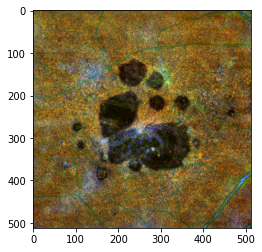

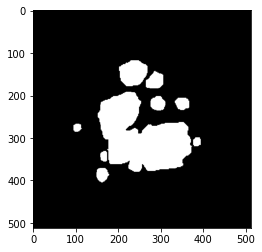

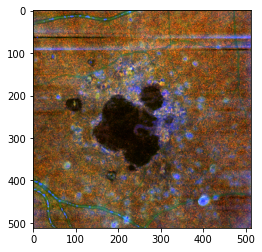

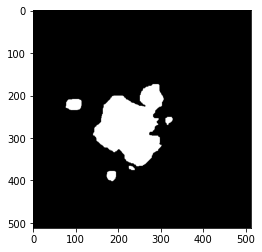

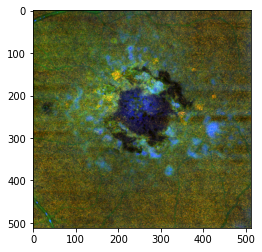

...

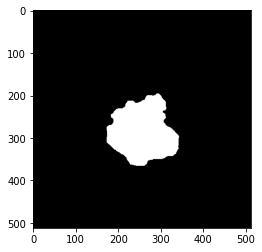

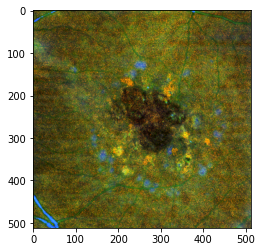

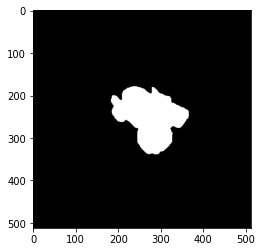

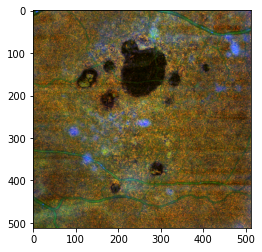

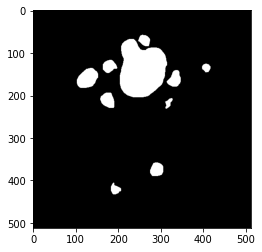

In [29]:
from matplotlib import pyplot as plt

for i in range(0,15):
   plt.imshow(np.squeeze(X_test[i,:,:]),cmap='gray',vmin=0,vmax=1)
   plt.show()
   plt.imshow(np.squeeze(Y_test[i,:,:]),cmap='gray',vmin=0,vmax=1)
   plt.show()


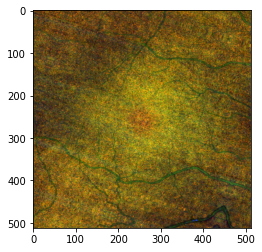

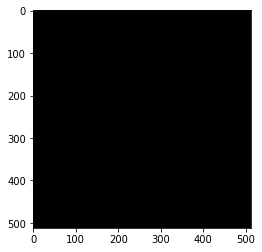

In [30]:
seed=4562
BATCH_SIZE = 16

# Creating the training Image and Mask generator
image_datagen = image.ImageDataGenerator(shear_range=0.5, rotation_range=20, zoom_range=0.1,  fill_mode='reflect')
mask_datagen = image.ImageDataGenerator(shear_range=0.5, rotation_range=20, zoom_range=0.1, fill_mode='reflect')

# Keep the same seed for image and mask generators so they fit together

image_datagen.fit(X_train[:int(X_train.shape[0]*0.8)], augment=True, seed=seed)
mask_datagen.fit(Y_train[:int(Y_train.shape[0]*0.8)], augment=True, seed=seed)

x=image_datagen.flow(X_train[:int(X_train.shape[0]*0.8)],batch_size=BATCH_SIZE,shuffle=True, seed=seed)
y=mask_datagen.flow(Y_train[:int(Y_train.shape[0]*0.8)],batch_size=BATCH_SIZE,shuffle=True, seed=seed)



# Creating the validation Image and Mask generator
image_datagen_val = image.ImageDataGenerator()
mask_datagen_val = image.ImageDataGenerator()

image_datagen_val.fit(X_train[int(X_train.shape[0]*0.8):], augment=True, seed=seed)
mask_datagen_val.fit(Y_train[int(Y_train.shape[0]*0.8):], augment=True, seed=seed)

x_val=image_datagen_val.flow(X_train[int(X_train.shape[0]*0.8):],batch_size=BATCH_SIZE,shuffle=True, seed=seed)
y_val=mask_datagen_val.flow(Y_train[int(Y_train.shape[0]*0.8):],batch_size=BATCH_SIZE,shuffle=True, seed=seed)

#creating a training and validation generator that generate masks and images
train_generator = zip(x, y)
val_generator = zip(x_val, y_val)


plt.imshow(np.squeeze(x.next()[3].astype(np.float32)),cmap = 'gray',vmin =0,vmax=1)
plt.show()
plt.imshow(np.squeeze(y.next()[3].astype(np.uint8)),cmap = 'gray',vmin =0,vmax=1)
plt.show()

In [31]:
from skimage.transform import resize
from skimage.io import imsave
import numpy as np
from keras.models import Model
from keras.layers import Input, concatenate, Conv2D, MaxPooling2D, Conv2DTranspose,Dropout,BatchNormalization,Activation
from keras.optimizers import Adam
from keras.callbacks import ModelCheckpoint, EarlyStopping
from keras import backend as K
import tensorflow as tf


K.set_image_data_format('channels_last')  # TF dimension ordering in this code

img_rows = 512
img_cols = 512

smooth = 1.

# def mean_iou(y_true, y_pred):
#    score, up_opt = tf.keras.metrics.MeanIoU(y_true, y_pred, 1)
#    K.get_session().run(tf.local_variables_initializer())
#    with tf.control_dependencies([up_opt]):
#        score = tf.identity(score)
#    return score


def dice_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f, axis=-1)
    sums = K.sum(y_true_f, axis=-1) + K.sum(y_pred_f, axis=-1)
    return (2. * intersection + smooth) / (sums + smooth)


def dice_coef_loss(y_true, y_pred):
    return -dice_coef(y_true, y_pred)

MM = 0.05

def get_unet():

    inputs = Input((img_rows, img_cols, 3))

    conv1 = Conv2D(32, (3, 3),kernel_initializer='he_normal',  padding='same')(inputs)
    conv1 = BatchNormalization(axis = 1, momentum= MM, scale = False)(conv1)
    conv1 = Activation('relu')(conv1)
    conv1 = Conv2D(32, (3, 3),kernel_initializer='he_normal', padding='same')(conv1)
    conv1 = BatchNormalization(axis = 1, momentum= MM, scale = False)(conv1)
    conv1 = Activation('relu')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(64, (3, 3), kernel_initializer='he_normal',padding='same')(pool1)
    conv2 = BatchNormalization(axis = 1, momentum= MM, scale = False)(conv2)
    conv2 = Activation('relu')(conv2)    
    conv2 = Conv2D(64, (3, 3), kernel_initializer='he_normal', padding='same')(conv2)
    conv2 = BatchNormalization(axis = 1, momentum= MM,scale = False)(conv2)
    conv2 = Activation('relu')(conv2)    
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = Conv2D(128, (3, 3),kernel_initializer='he_normal',  padding='same')(pool2)
    conv3 = BatchNormalization(axis = 1, momentum= MM, scale = False)(conv3)
    conv3 = Activation('relu')(conv3)
    conv3 = Conv2D(128, (3, 3), kernel_initializer='he_normal', padding='same')(conv3)
    conv3 = BatchNormalization(axis = 1, momentum= MM, scale = False)(conv3)
    conv3 = Activation('relu')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    conv4 = Conv2D(256, (3, 3), kernel_initializer='he_normal', padding='same')(pool3)
    conv4 = BatchNormalization(axis = 1, momentum= MM, scale = False)(conv4)
    conv4 = Activation('relu')(conv4)
    conv4 = Conv2D(256, (3, 3), kernel_initializer='he_normal', padding='same')(conv4)
    conv4 = BatchNormalization(axis = 1, momentum= MM, scale = False)(conv4)
    conv4 = Activation('relu')(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)

    conv5 = Conv2D(512, (3, 3), kernel_initializer='he_normal',padding='same')(pool4)
    conv5 = BatchNormalization(axis = 1, momentum= MM, scale = False)(conv5)
    conv5 = Activation('relu')(conv5)
    conv5 = Conv2D(512, (3, 3), kernel_initializer='he_normal', padding='same')(conv5)
    conv5 = BatchNormalization(axis = 1, momentum= MM, scale = False)(conv5)
    conv5 = Activation('relu')(conv5)

    up6 = concatenate([Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(conv5), conv4], axis=3)
    up6 = Dropout(0.3)(up6)
    conv6 = Conv2D(256, (3, 3),kernel_initializer='he_normal', padding='same')(up6)
    conv6 = BatchNormalization(axis = 1, momentum= MM, scale = False)(conv6)
    conv6 = Activation('relu')(conv6)
    conv6 = Conv2D(256, (3, 3), kernel_initializer='he_normal',padding='same')(conv6)
    conv6 = BatchNormalization(axis = 1, momentum= MM, scale = False)(conv6)
    conv6 = Activation('relu')(conv6)

    up7 = concatenate([Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(conv6), conv3], axis=3)
    up7 = Dropout(0.3)(up7)
    conv7 = Conv2D(128, (3, 3), kernel_initializer='he_normal',padding='same')(up7)
    conv7 = BatchNormalization(axis = 1, momentum= MM, scale = False)(conv7)
    conv7 = Activation('relu')(conv7)
    conv7 = Conv2D(128, (3, 3), kernel_initializer='he_normal',padding='same')(conv7)
    conv7 = BatchNormalization(axis = 1, momentum= MM, scale = False)(conv7)
    conv7 = Activation('relu')(conv7)

    up8 = concatenate([Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(conv7), conv2], axis=3)
    up8 = Dropout(0.4)(up8)
    conv8 = Conv2D(64, (3, 3),kernel_initializer='he_normal',padding='same')(up8)
    conv8 = BatchNormalization(axis = 1, momentum= MM, scale = False)(conv8)
    conv8 = Activation('relu')(conv8)
    conv8 = Conv2D(64, (3, 3),kernel_initializer='he_normal', padding='same')(conv8)
    conv8 = BatchNormalization(axis = 1, momentum= MM, scale = False)(conv8)
    conv8 = Activation('relu')(conv8)

    up9 = concatenate([Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(conv8), conv1], axis=3)
    up9 = Dropout(0.4)(up9)
    conv9 = Conv2D(32, (3, 3), kernel_initializer='he_normal', padding='same')(up9)
    conv9 = BatchNormalization(axis = 1, momentum= MM, scale = False)(conv9)
    conv9 = Activation('relu')(conv9)
    conv9 = Conv2D(32, (3, 3), kernel_initializer='he_normal', padding='same')(conv9)
    conv9 = BatchNormalization(axis = 1, momentum= MM, scale = False)(conv9)
    conv9 = Activation('relu')(conv9)

    conv10 = Conv2D(1, (1, 1), activation='sigmoid')(conv9)

    model = Model(inputs=[inputs], outputs=[conv10])
    precision = tf.keras.metrics.Precision()
    model.compile(optimizer=Adam(learning_rate=1e-4), loss= dice_coef_loss, metrics=[dice_coef])

    return model



In [36]:
model = get_unet()
checkpointer = [ModelCheckpoint('weights.h5', verbose=1, save_best_only=True),
                EarlyStopping(patience=150, verbose=2)]



history = model.fit(train_generator,validation_data=val_generator, 
                    steps_per_epoch=len(X_train)//BATCH_SIZE+1,
                    validation_steps=len(X_test)//BATCH_SIZE+1, 
                    epochs=200, verbose=1,callbacks=checkpointer)

Epoch 1/200
8/8 [==============================] - 10s 1s/step - loss: -0.1904 - dice_coef: 0.1908 - val_loss: -0.2329 - val_dice_coef: 0.2757

Epoch 00001: val_loss improved from inf to -0.23289, saving model to weights.h5
Epoch 2/200
8/8 [==============================] - 7s 954ms/step - loss: -0.2003 - dice_coef: 0.1928 - val_loss: -0.2613 - val_dice_coef: 0.2661

Epoch 00002: val_loss improved from -0.23289 to -0.26131, saving model to weights.h5
Epoch 3/200
8/8 [==============================] - 8s 1s/step - loss: -0.2583 - dice_coef: 0.2598 - val_loss: -0.3065 - val_dice_coef: 0.2786

Epoch 00003: val_loss improved from -0.26131 to -0.30654, saving model to weights.h5
Epoch 4/200
8/8 [==============================] - 8s 1s/step - loss: -0.3198 - dice_coef: 0.3206 - val_loss: -0.3177 - val_dice_coef: 0.2915

Epoch 00004: val_loss improved from -0.30654 to -0.31765, saving model to weights.h5
Epoch 5/200
8/8 [==============================] - 7s 929ms/step - loss: -0.3303 - dice_c

dict_keys(['loss', 'dice_coef', 'val_loss', 'val_dice_coef'])


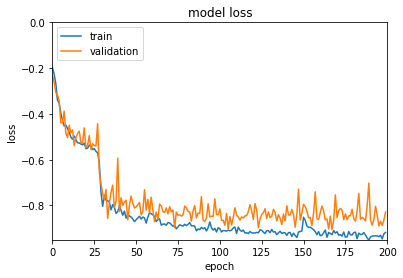

In [39]:
print(history.history.keys())

from keras.models import Sequential
from keras.layers import Dense
import matplotlib.pyplot as plt
import numpy


# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.axis([0,200,-0.95,0])
plt.show()

4/4 [==============================] - 0s 143ms/step
1/1 - 0s - loss: -9.1759e-01 - dice_coef: 0.9176
model accuracy: 91.76%


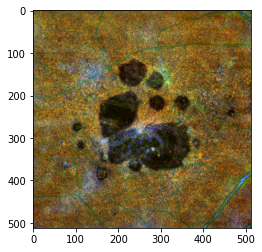

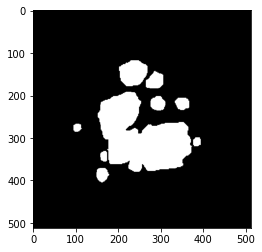

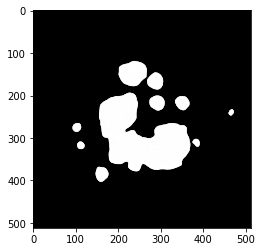

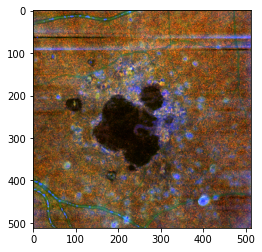

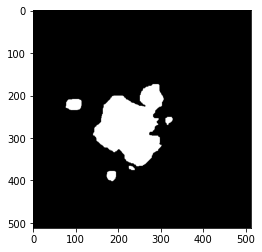

...

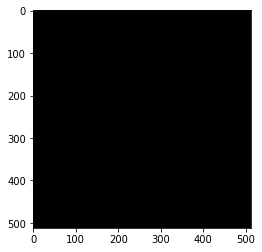

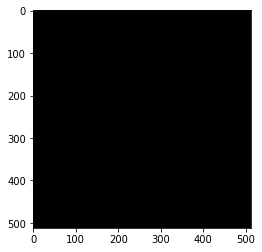

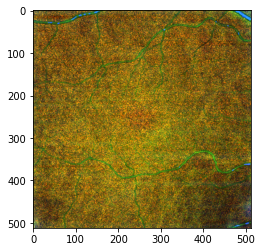

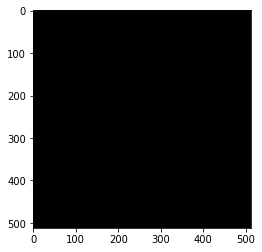

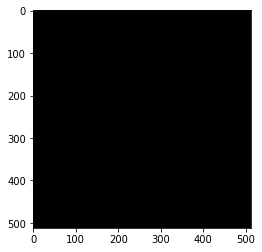

In [40]:
Y_test_Model = model.predict(X_test, verbose=1,batch_size = 8)
 

 
loss, acc = model.evaluate( X_test, Y_test, verbose=2)
print("model accuracy: {:5.2f}%".format(100 * acc))

for i in range(0,28):
   plt.imshow(np.squeeze(X_test[i,:,:]),cmap='gray')
   plt.show()
   plt.imshow(np.squeeze(Y_test[i,:,:]),cmap='gray',vmin=0,vmax=1)
   plt.show()
   xxx=np.squeeze(Y_test_Model[i,:,:])
   plt.imshow(xxx,cmap='gray',vmin=0.5,vmax=1)
   plt.show()

In [45]:
model.save("//content/drive/MyDrive/ARVOHTD/PaperResults/UNetResults/RGBInput/RGBModel.h5")
model.save_weights("//content/drive/MyDrive/ARVOHTD/PaperResults/UNetResults/RGBInput/RGBWeights.h5")


4/4 [==============================] - 2s 518ms/step


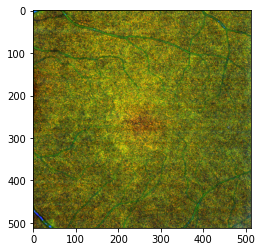

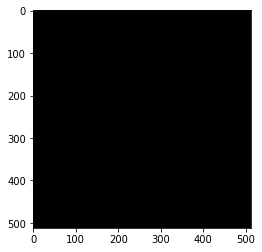

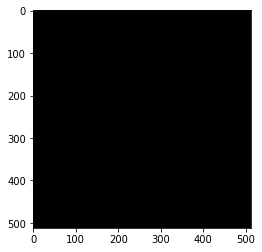

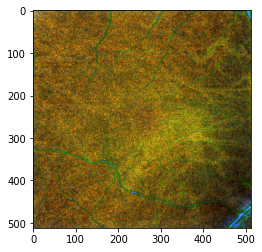

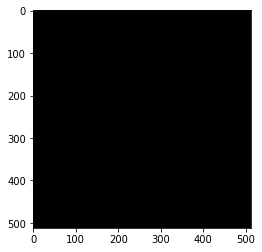

...

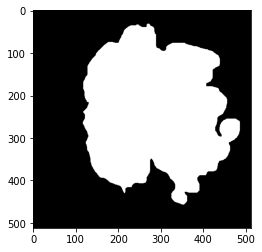

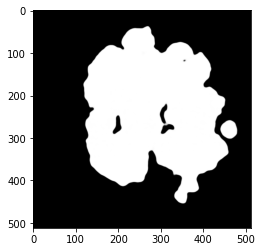

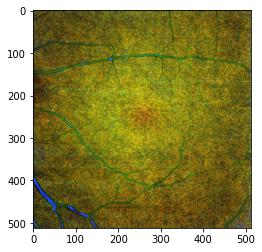

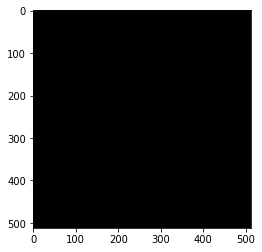

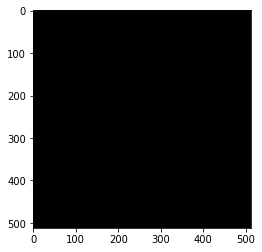

IndexError: ignored

In [46]:
imgs = X_train
imgs_mask = Y_train

imgs_mask_model = model.predict(imgs, verbose=1)
# Display results for validation image #10
for i in range(0,122):
   plt.imshow(np.squeeze(imgs[i,:,:]),cmap='gray')
   plt.show()
   plt.imshow(np.squeeze(imgs_mask[i,:,:]),cmap='gray',vmin=0,vmax=1)
   plt.show()
   xxx=np.squeeze(imgs_mask_model[i,:,:])
   plt.imshow(xxx,cmap='gray',vmin=0,vmax=1)
   plt.show() 

In [47]:
np.save('/content/drive/MyDrive/ARVOHTD/PaperResults/UNetResults/RGBInput/112TrainingResultsARVO.npy',imgs_mask_model)
np.save('/content/drive/MyDrive/ARVOHTD/PaperResults/UNetResults/RGBInput28TestResultsARVO.npy',Y_test_Model)
np.save('/content/drive/MyDrive/ARVOHTD/PaperResults/UNetResults/RGBInputX_Train.npy',X_train)
np.save('/content/drive/MyDrive/ARVOHTD/PaperResults/UNetResults/RGBInputY_Train.npy',Y_train)